<a href="https://colab.research.google.com/github/ritwiks9635/Generative_Model/blob/main/Neural_Style_Transfer_using_AdaIN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#**Neural Style Transfer using Multiple Image**

[Best Artworks Dataset](https://www.kaggle.com/datasets/ikarus777/best-artworks-of-all-time)

In [3]:
! mkdir /content/artwork
! unzip -qq /content/https:/www.kaggle.com/datasets/ikarus777/best-artworks-of-all-time/best-artworks-of-all-time.zip
! rm -rf images
! mv resized artwork
! rm /content/https:/www.kaggle.com/datasets/ikarus777/best-artworks-of-all-time/best-artworks-of-all-time.zip artists.csv

In [4]:
os.listdir("/content/artwork/resized/resized")

['Marc_Chagall_192.jpg',
 'Henri_Rousseau_22.jpg',
 'Sandro_Botticelli_72.jpg',
 'Albrecht_Du╠Иrer_300.jpg',
 'Giotto_di_Bondone_84.jpg',
 'Albrecht_DuтХа├кrer_83.jpg',
 'Raphael_96.jpg',
 'Vincent_van_Gogh_730.jpg',
 'Pierre-Auguste_Renoir_94.jpg',
 'Marc_Chagall_128.jpg',
 'Titian_214.jpg',
 'Francisco_Goya_129.jpg',
 'Edouard_Manet_75.jpg',
 'Edgar_Degas_212.jpg',
 'Mikhail_Vrubel_161.jpg',
 'Alfred_Sisley_94.jpg',
 'Paul_Klee_138.jpg',
 'Marc_Chagall_101.jpg',
 'Diego_Velazquez_14.jpg',
 'Francisco_Goya_148.jpg',
 'Rembrandt_69.jpg',
 'Albrecht_Du╠Иrer_257.jpg',
 'Edgar_Degas_579.jpg',
 'Amedeo_Modigliani_164.jpg',
 'Marc_Chagall_178.jpg',
 'Gustav_Klimt_82.jpg',
 'Joan_Miro_49.jpg',
 'Amedeo_Modigliani_11.jpg',
 'Marc_Chagall_32.jpg',
 'Leonardo_da_Vinci_104.jpg',
 'Albrecht_Du╠Иrer_189.jpg',
 'Edgar_Degas_509.jpg',
 'Edgar_Degas_262.jpg',
 'Albrecht_DuтХа├кrer_146.jpg',
 'Claude_Monet_71.jpg',
 'Gustav_Klimt_68.jpg',
 'Rembrandt_88.jpg',
 'Alfred_Sisley_144.jpg',
 'Paul_Gauguin_1

In [5]:
import numpy as np
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds
from tensorflow.keras import layers

In [6]:
img_size = (224, 224)
batch_size = 32
epochs = 30

In [7]:
def preprocess_image(img_path):
    image = tf.io.read_file(img_path)
    image = tf.image.decode_jpeg(image, channels = 3)
    image = tf.image.convert_image_dtype(image, "float32")
    image = tf.image.resize(image, img_size)
    return image


def extract_image_from_tfds(files):
    image = files["image"]
    image = tf.image.convert_image_dtype(image, "float32")
    image = tf.image.resize(image, img_size)
    return image

In [8]:
style_paths = "/content/artwork/resized/resized"
style_images = [os.path.join(style_paths, image) for image in os.listdir(style_paths)]

In [9]:
total_imgs = len(style_images)
print("Total Style images is :: ", total_imgs)

train_style = style_images[: int(0.8 * total_imgs)]
valid_style = style_images[int(0.8 * total_imgs) : int(0.9 * total_imgs)]
test_style = style_images[int(0.9 * total_imgs) :]
print("Total Train Style images is :: ", len(train_style))
print("Total Valid style images is :: ", len(valid_style))
print("Total Test style images is :: ", len(test_style))

Total Style images is ::  8683
Total Train Style images is ::  6946
Total Valid style images is ::  868
Total Test style images is ::  869


In [10]:
train_style_ds = (tf.data.Dataset.from_tensor_slices(train_style)
    .map(preprocess_image, num_parallel_calls = tf.data.AUTOTUNE)
    .repeat())

train_content_ds = tfds.load("voc", split = "train").map(extract_image_from_tfds).repeat()


valid_style_ds = (tf.data.Dataset.from_tensor_slices(valid_style)
    .map(preprocess_image, num_parallel_calls = tf.data.AUTOTUNE)
    .repeat())

valid_content_ds = tfds.load("voc", split = "validation").map(extract_image_from_tfds).repeat()



test_style_ds = (tf.data.Dataset.from_tensor_slices(test_style)
    .map(preprocess_image, num_parallel_calls = tf.data.AUTOTUNE)
    .repeat())

test_content_ds = tfds.load("voc", split = "test").map(extract_image_from_tfds).repeat()

Dl Completed...: 0 url [00:00, ? url/s]

Dl Size...: 0 MiB [00:00, ? MiB/s]

Extraction completed...: 0 file [00:00, ? file/s]

Generating splits...:   0%|          | 0/3 [00:00<?, ? splits/s]

Generating test examples...:   0%|          | 0/4952 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/voc/2007/4.0.0.incompleteFC00ED/voc-test.tfrecord*...:   0%|          | 0/…

Generating train examples...:   0%|          | 0/2501 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/voc/2007/4.0.0.incompleteFC00ED/voc-train.tfrecord*...:   0%|          | 0…

Generating validation examples...:   0%|          | 0/2510 [00:00<?, ? examples/s]

Shuffling /root/tensorflow_datasets/voc/2007/4.0.0.incompleteFC00ED/voc-validation.tfrecord*...:   0%|        …

Dataset voc downloaded and prepared to /root/tensorflow_datasets/voc/2007/4.0.0. Subsequent calls will reuse this data.


In [11]:
train_dataset = (tf.data.Dataset.zip((train_style_ds, train_content_ds))
    .shuffle(batch_size * 2)
    .batch(batch_size)
    .prefetch(tf.data.AUTOTUNE))

valid_dataset = (tf.data.Dataset.zip((valid_style_ds, valid_content_ds))
    .shuffle(batch_size * 2)
    .batch(batch_size)
    .prefetch(tf.data.AUTOTUNE))

test_dataset = (tf.data.Dataset.zip((test_style_ds, test_content_ds))
    .shuffle(batch_size * 2)
    .batch(batch_size)
    .prefetch(tf.data.AUTOTUNE))

Style image shape is ::  (32, 224, 224, 3) 
Content Image shape is ::  (32, 224, 224, 3)


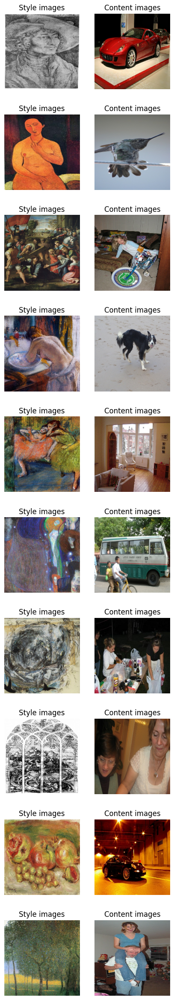

In [12]:
style, content = next(iter(train_dataset))
print("Style image shape is :: ",style.shape,"\nContent Image shape is :: ", content.shape)
fig, axes = plt.subplots(10, 2, figsize = (5, 30))
[ax.axis("off") for ax in np.ravel(axes)]

for axis, style_images, content_images in zip(axes, style[:10], content[:10]):
    style_ax, content_ax = axis

    style_ax.imshow(style_images)
    style_ax.set_title("Style images")

    content_ax.imshow(content_images)
    content_ax.set_title("Content images")

plt.show()

## Architecture

The style transfer network takes a content image and a style image as
inputs and outputs the style transferred image. The authors of AdaIN
propose a simple encoder-decoder structure for achieving this.

![AdaIN architecture](https://i.imgur.com/JbIfoyE.png)

The content image (`C`) and the style image (`S`) are both fed to the
encoder networks. The output from these encoder networks (feature maps)
are then fed to the AdaIN layer. The AdaIN layer computes a combined
feature map. This feature map is then fed into a randomly initialized
decoder network that serves as the generator for the neural style
transferred image.

![AdaIn equation](https://i.imgur.com/hqhcBQS.png)

The style feature map (`fs`) and the content feature map (`fc`) are
fed to the AdaIN layer. This layer produced the combined feature map
`t`. The function `g` represents the decoder (generator) network.

In [13]:
def encoder_layers():
    model = keras.applications.VGG19(
        weights = "imagenet",
        include_top = False,
        input_shape = (*img_size, 3)
    )

    model.trainble = False
    mini_model = keras.Model(inputs = model.input, outputs = model.get_layer("block4_conv1").output)

    inputs = keras.Input([*img_size, 3])
    mini_model_out = mini_model(inputs)

    return keras.Model(inputs, mini_model_out)

### Adaptive Instance Normalization

The AdaIN layer takes in the features
of the content and style image. The layer can be defined via the
following equation:

![AdaIn formula](https://i.imgur.com/tWq3VKP.png)

where `sigma` is the standard deviation and `mu` is the mean for the
concerned variable. In the above equation the mean and variance of the
content feature map `fc` is aligned with the mean and variance of the
style feature maps `fs`.

It is important to note that the AdaIN layer proposed by the authors
uses no other parameters apart from mean and variance. The layer also
does not have any trainable parameters. This is why we use a
*Python function* instead of using a *Keras layer*. The function takes
style and content feature maps, computes the mean and standard deviation
of the images and returns the adaptive instance normalized feature map.

In [14]:
def cal_mean_std(x, epsilon = 1e-5):
    axes = [1, 2]
    mean, variance = tf.nn.moments(x, axes = axes, keepdims = True)
    std = tf.sqrt(variance + epsilon)
    return mean, std

def AdaIn_layer(style, content):
    content_mean, content_std = cal_mean_std(content)
    style_mean, style_std = cal_mean_std(style)
    adain_l = style_std * (content - content_mean) / content_std + style_mean
    return adain_l

In [15]:
def decoder_layers():
    config = {"kernel_size": 3, "strides": 1, "padding": "same", "activation": "relu"}

    decoder = keras.Sequential(
        [
            keras.Input(shape = (None, None, 512)),
            layers.Conv2D(512, **config),
            layers.UpSampling2D(),
            layers.Conv2D(256, **config),
            layers.Conv2D(256, **config),
            layers.Conv2D(256, **config),
            layers.Conv2D(256, **config),
            layers.UpSampling2D(),
            layers.Conv2D(128, **config),
            layers.Conv2D(128, **config),
            layers.UpSampling2D(),
            layers.Conv2D(64, **config),
            layers.Conv2D(3, kernel_size = 3, strides = 1, padding = "same", activation = "sigmoid")
        ])

    return decoder

### Loss functions

Here we build the loss functions for the neural style transfer model.
The authors propose to use a pretrained VGG-19 to compute the loss
function of the network. It is important to keep in mind that this
will be used for training only the decoder network. The total
loss (`Lt`) is a weighted combination of content loss (`Lc`) and style
loss (`Ls`). The `lambda` term is used to vary the amount of style
transferred.

![The total loss](https://i.imgur.com/Q5y1jUM.png)

### Content Loss

This is the Euclidean distance between the content image features
and the features of the neural style transferred image.

![The content loss](https://i.imgur.com/dZ0uD0N.png)

Here the authors propose to use the output from the AdaIn layer `t` as
the content target rather than using features of the original image as
target. This is done to speed up convergence.

### Style Loss

Rather than using the more commonly used
[Gram Matrix](https://mathworld.wolfram.com/GramMatrix.html),
the authors propose to compute the difference between the statistical features
(mean and variance) which makes it conceptually cleaner. This can be
easily visualized via the following equation:

![The style loss](https://i.imgur.com/Ctclhn3.png)

where `theta` denotes the layers in VGG-19 used to compute the loss.
In this case this corresponds to:

- `block1_conv1`
- `block1_conv2`
- `block1_conv3`
- `block1_conv4`

In [16]:
def get_loss_net():
    vgg19 = keras.applications.VGG19(
        weights = "imagenet", include_top = False, input_shape = (*img_size, 3))

    vgg19.trainable = False

    layers = ["block1_conv1", "block2_conv1", "block3_conv1", "block4_conv1"]

    outputs = [vgg19.get_layer(name).output for name in layers]

    mini_vgg19 = keras.Model(vgg19.input, outputs)

    inputs = keras.Input([*img_size, 3])
    vgg19_outputs = mini_vgg19(inputs)

    return keras.Model(inputs, vgg19_outputs)

In [17]:
class NeuralStyleTransfer(keras.Model):
    def __init__(self, encoder, decoder, loss_net, style_weight, **kwargs):
        super().__init__(**kwargs)
        self.encoder = encoder
        self.decoder = decoder
        self.loss_net = loss_net
        self.style_weight = style_weight


    def compile(self, optimizer, loss_fn):
        super().compile()
        self.optimizer = optimizer
        self.loss_fn = loss_fn
        self.style_loss_tracker = keras.metrics.Mean("style_loss")
        self.content_loss_tracker = keras.metrics.Mean("content_loss")
        self.total_loss_tracker = keras.metrics.Mean("total_loss")


    def train_step(self, inputs):
        style, content = inputs

        # Initialize the content and style loss.
        loss_content = 0.0
        loss_style = 0.0

        with tf.GradientTape() as tape:
            # Encode the style and content image.
            style_encoded = self.encoder(style)
            content_encoded = self.encoder(content)

            # Compute the AdaIN target feature maps.
            t = AdaIn_layer(style=style_encoded, content=content_encoded)

            # Generate the neural style transferred image.
            reconstructed_image = self.decoder(t)

            # Compute the losses.
            reconstructed_vgg_features = self.loss_net(reconstructed_image)
            style_vgg_features = self.loss_net(style)
            loss_content = self.loss_fn(t, reconstructed_vgg_features[-1])
            for inp, out in zip(style_vgg_features, reconstructed_vgg_features):
                mean_inp, std_inp = cal_mean_std(inp)
                mean_out, std_out = cal_mean_std(out)
                loss_style += self.loss_fn(mean_inp, mean_out) + self.loss_fn(
                    std_inp, std_out
                )
            loss_style = self.style_weight * loss_style
            total_loss = loss_content + loss_style

        # Compute gradients and optimize the decoder.
        trainable_vars = self.decoder.trainable_variables
        gradients = tape.gradient(total_loss, trainable_vars)
        self.optimizer.apply_gradients(zip(gradients, trainable_vars))

        # Update the trackers.
        self.style_loss_tracker.update_state(loss_style)
        self.content_loss_tracker.update_state(loss_content)
        self.total_loss_tracker.update_state(total_loss)
        return {
            "style_loss": self.style_loss_tracker.result(),
            "content_loss": self.content_loss_tracker.result(),
            "total_loss": self.total_loss_tracker.result(),
        }

    def test_step(self, inputs):
        style, content = inputs

        # Initialize the content and style loss.
        loss_content = 0.0
        loss_style = 0.0

        # Encode the style and content image.
        style_encoded = self.encoder(style)
        content_encoded = self.encoder(content)

        # Compute the AdaIN target feature maps.
        t = AdaIn_layer(style=style_encoded, content=content_encoded)

        # Generate the neural style transferred image.
        reconstructed_image = self.decoder(t)

        # Compute the losses.
        recons_vgg_features = self.loss_net(reconstructed_image)
        style_vgg_features = self.loss_net(style)
        loss_content = self.loss_fn(t, recons_vgg_features[-1])
        for inp, out in zip(style_vgg_features, recons_vgg_features):
            mean_inp, std_inp = cal_mean_std(inp)
            mean_out, std_out = cal_mean_std(out)
            loss_style += self.loss_fn(mean_inp, mean_out) + self.loss_fn(
                std_inp, std_out
            )
        loss_style = self.style_weight * loss_style
        total_loss = loss_content + loss_style

        # Update the trackers.
        self.style_loss_tracker.update_state(loss_style)
        self.content_loss_tracker.update_state(loss_content)
        self.total_loss_tracker.update_state(total_loss)
        return {
            "style_loss": self.style_loss_tracker.result(),
            "content_loss": self.content_loss_tracker.result(),
            "total_loss": self.total_loss_tracker.result(),
        }

    @property
    def metrics(self):
        return [
            self.style_loss_tracker,
            self.content_loss_tracker,
            self.total_loss_tracker,
        ]

###**Visualize Callbacks**

In [21]:
test_style, test_content = next(iter(test_dataset))


class TrainMonitor(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs=None):
        # Encode the style and content image.
        test_style_encoded = self.model.encoder(test_style)
        test_content_encoded = self.model.encoder(test_content)

        # Compute the AdaIN features.
        test_t = AdaIn_layer(style=test_style_encoded, content=test_content_encoded)
        test_reconstructed_image = self.model.decoder(test_t)

        # Plot the Style, Content and the NST image.
        fig, ax = plt.subplots(nrows=1, ncols=3, figsize=(20, 5))
        ax[0].imshow(tf.keras.utils.array_to_img(test_style[0]))
        ax[0].set_title(f"Style: {epoch:03d}")

        ax[1].imshow(tf.keras.utils.array_to_img(test_content[0]))
        ax[1].set_title(f"Content: {epoch:03d}")

        ax[2].imshow(
            tf.keras.utils.array_to_img(test_reconstructed_image[0])
        )
        ax[2].set_title(f"NST: {epoch:03d}")

        plt.show()
        plt.close()

In [19]:
optimizer = keras.optimizers.Adam(learning_rate = 1e-5)
loss = keras.losses.MeanSquaredError()

encoder = encoder_layers()
decoder = decoder_layers()
loss_net = get_loss_net()

model = NeuralStyleTransfer(encoder = encoder, decoder = decoder, loss_net = loss_net, style_weight = 4.0)

80134624/80134624 [==============================] - 0s 0us/step


Epoch 1/30
50/50 [==============================] - ETA: 0s - style_loss: 175.9390 - content_loss: 130.6847 - total_loss: 306.6237

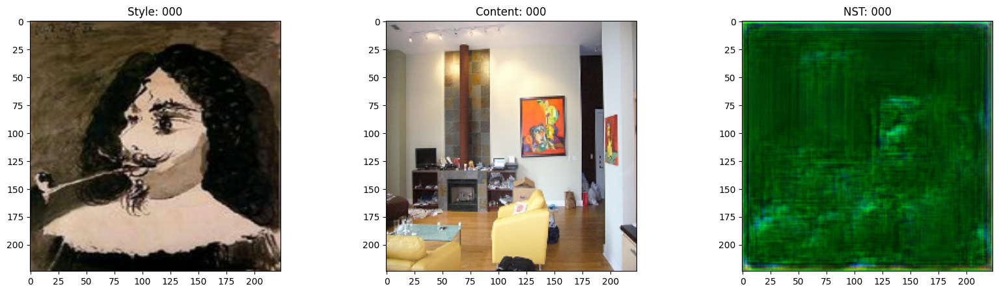

50/50 [==============================] - 105s 2s/step - style_loss: 175.9390 - content_loss: 130.6847 - total_loss: 306.6237 - val_style_loss: 167.5261 - val_content_loss: 123.5379 - val_total_loss: 291.0640
Epoch 2/30
50/50 [==============================] - ETA: 0s - style_loss: 150.5257 - content_loss: 119.6566 - total_loss: 270.1824

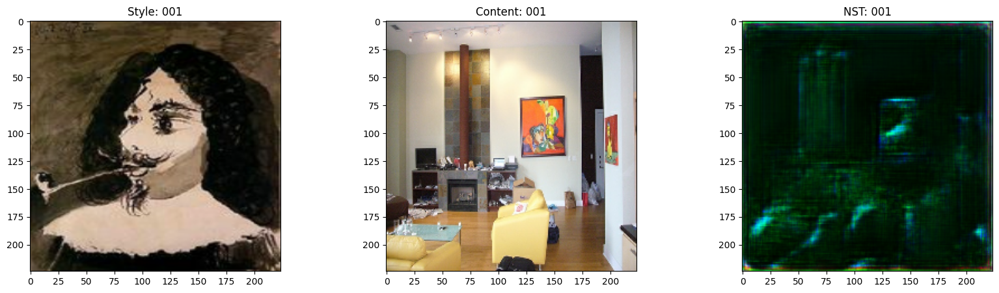

50/50 [==============================] - 93s 2s/step - style_loss: 150.5257 - content_loss: 119.6566 - total_loss: 270.1824 - val_style_loss: 139.2124 - val_content_loss: 115.0215 - val_total_loss: 254.2338
Epoch 3/30
50/50 [==============================] - ETA: 0s - style_loss: 127.2152 - content_loss: 109.6645 - total_loss: 236.8797

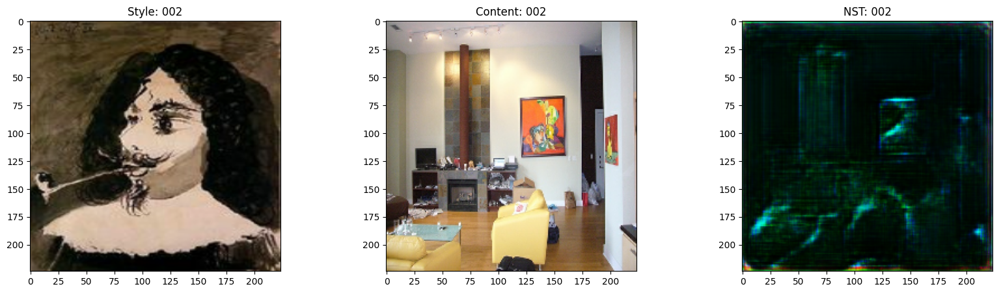

50/50 [==============================] - 103s 2s/step - style_loss: 127.2152 - content_loss: 109.6645 - total_loss: 236.8797 - val_style_loss: 121.9274 - val_content_loss: 107.4195 - val_total_loss: 229.3469
Epoch 4/30
50/50 [==============================] - ETA: 0s - style_loss: 110.7636 - content_loss: 103.4144 - total_loss: 214.1780

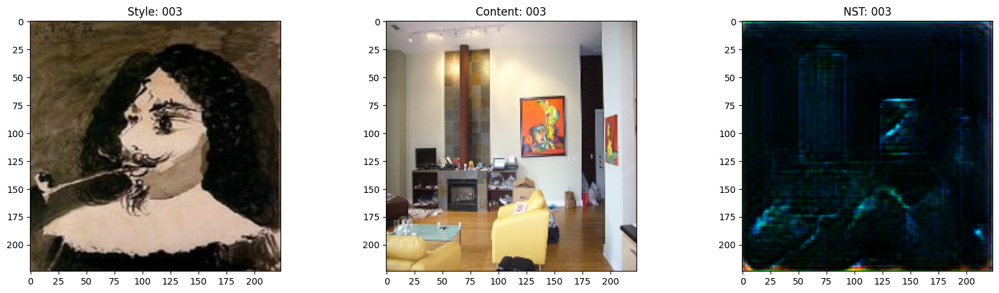

50/50 [==============================] - 104s 2s/step - style_loss: 110.7636 - content_loss: 103.4144 - total_loss: 214.1780 - val_style_loss: 104.3265 - val_content_loss: 101.2910 - val_total_loss: 205.6175
Epoch 5/30
50/50 [==============================] - ETA: 0s - style_loss: 93.0132 - content_loss: 97.5959 - total_loss: 190.6091

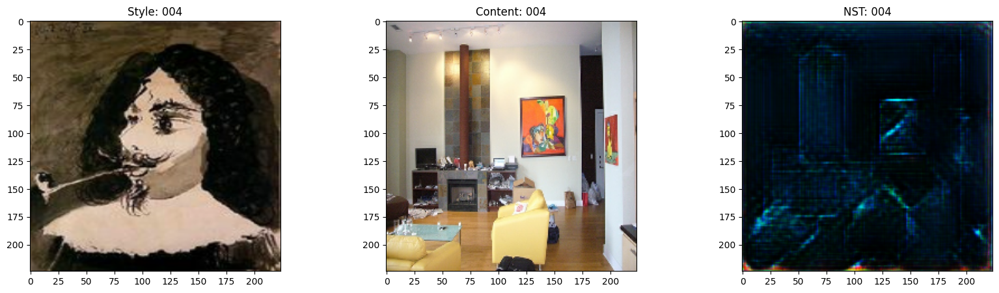

50/50 [==============================] - 94s 2s/step - style_loss: 93.0132 - content_loss: 97.5959 - total_loss: 190.6091 - val_style_loss: 92.0120 - val_content_loss: 96.5620 - val_total_loss: 188.5740
Epoch 6/30
50/50 [==============================] - ETA: 0s - style_loss: 87.8814 - content_loss: 95.2578 - total_loss: 183.1392

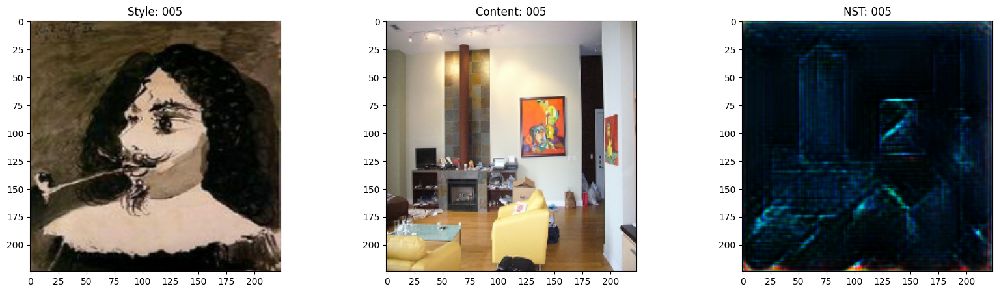

50/50 [==============================] - 94s 2s/step - style_loss: 87.8814 - content_loss: 95.2578 - total_loss: 183.1392 - val_style_loss: 85.9430 - val_content_loss: 94.3784 - val_total_loss: 180.3215
Epoch 7/30
50/50 [==============================] - ETA: 0s - style_loss: 82.6586 - content_loss: 92.3106 - total_loss: 174.9692

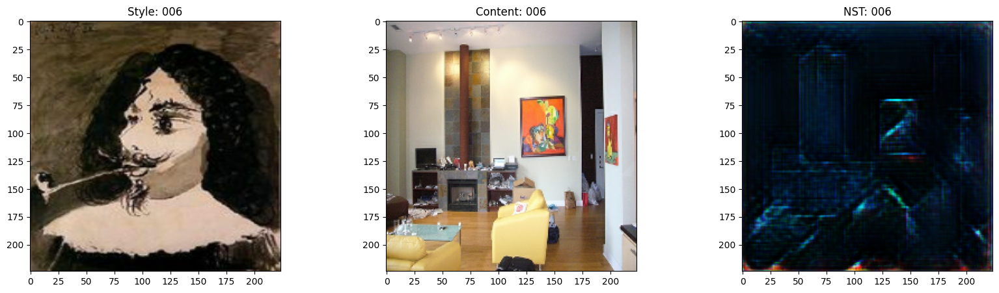

50/50 [==============================] - 103s 2s/step - style_loss: 82.6586 - content_loss: 92.3106 - total_loss: 174.9692 - val_style_loss: 81.5553 - val_content_loss: 90.0757 - val_total_loss: 171.6309
Epoch 8/30
50/50 [==============================] - ETA: 0s - style_loss: 77.2240 - content_loss: 87.9360 - total_loss: 165.1600

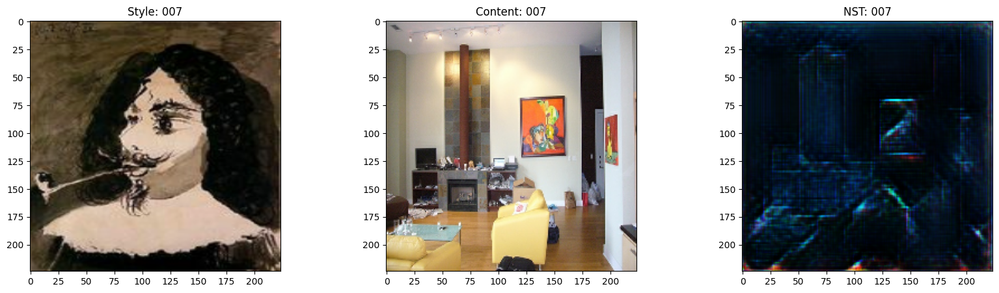

50/50 [==============================] - 103s 2s/step - style_loss: 77.2240 - content_loss: 87.9360 - total_loss: 165.1600 - val_style_loss: 77.6258 - val_content_loss: 88.1608 - val_total_loss: 165.7866
Epoch 9/30
50/50 [==============================] - ETA: 0s - style_loss: 73.0169 - content_loss: 85.4853 - total_loss: 158.5021

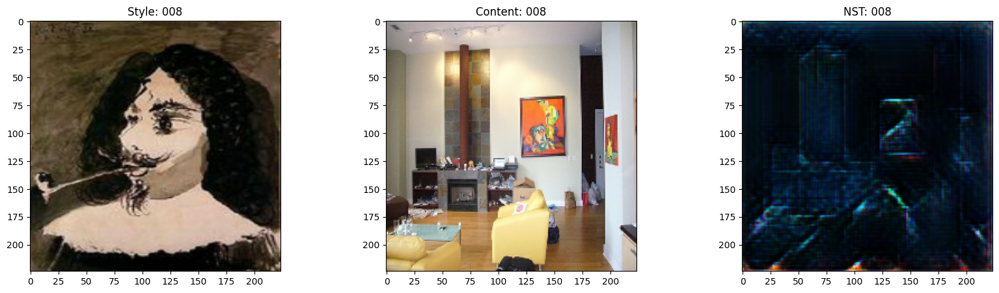

50/50 [==============================] - 103s 2s/step - style_loss: 73.0169 - content_loss: 85.4853 - total_loss: 158.5021 - val_style_loss: 75.0739 - val_content_loss: 84.6090 - val_total_loss: 159.6830
Epoch 10/30
50/50 [==============================] - ETA: 0s - style_loss: 71.5430 - content_loss: 84.5790 - total_loss: 156.1220

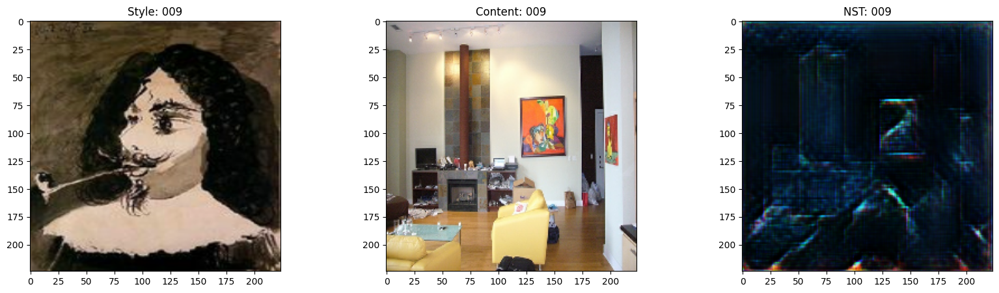

50/50 [==============================] - 94s 2s/step - style_loss: 71.5430 - content_loss: 84.5790 - total_loss: 156.1220 - val_style_loss: 69.8127 - val_content_loss: 84.1194 - val_total_loss: 153.9321
Epoch 11/30
50/50 [==============================] - ETA: 0s - style_loss: 67.3442 - content_loss: 82.3662 - total_loss: 149.7105

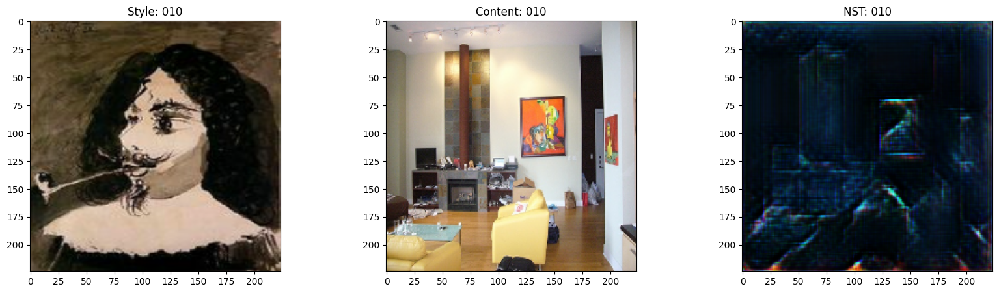

50/50 [==============================] - 94s 2s/step - style_loss: 67.3442 - content_loss: 82.3662 - total_loss: 149.7105 - val_style_loss: 67.7494 - val_content_loss: 80.9823 - val_total_loss: 148.7317
Epoch 12/30
50/50 [==============================] - ETA: 0s - style_loss: 64.1422 - content_loss: 79.7578 - total_loss: 143.9000

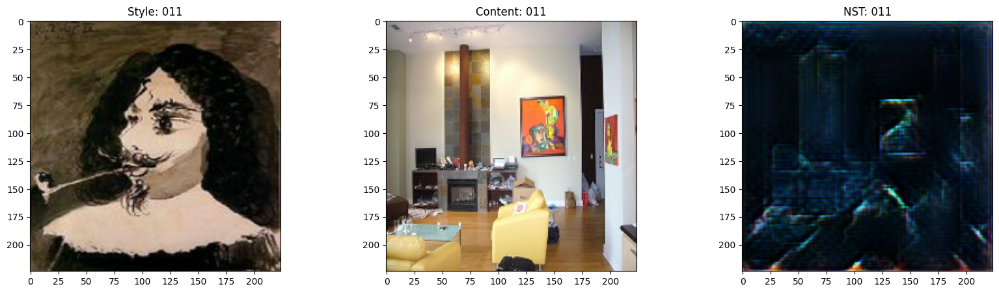

50/50 [==============================] - 103s 2s/step - style_loss: 64.1422 - content_loss: 79.7578 - total_loss: 143.9000 - val_style_loss: 65.0382 - val_content_loss: 79.3611 - val_total_loss: 144.3992
Epoch 13/30
50/50 [==============================] - ETA: 0s - style_loss: 60.9272 - content_loss: 77.3045 - total_loss: 138.2317

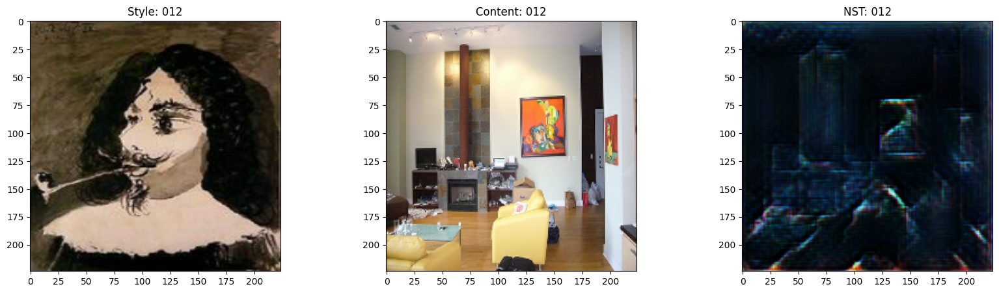

50/50 [==============================] - 94s 2s/step - style_loss: 60.9272 - content_loss: 77.3045 - total_loss: 138.2317 - val_style_loss: 62.6666 - val_content_loss: 77.1946 - val_total_loss: 139.8612
Epoch 14/30
50/50 [==============================] - ETA: 0s - style_loss: 59.9291 - content_loss: 77.2303 - total_loss: 137.1594

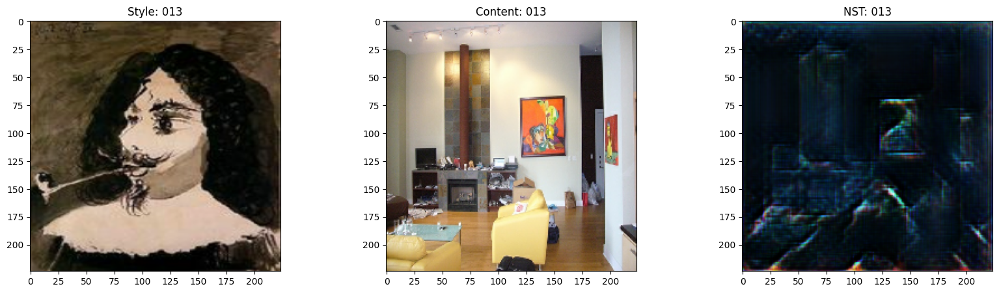

50/50 [==============================] - 93s 2s/step - style_loss: 59.9291 - content_loss: 77.2303 - total_loss: 137.1594 - val_style_loss: 60.2347 - val_content_loss: 75.9036 - val_total_loss: 136.1383
Epoch 15/30
50/50 [==============================] - ETA: 0s - style_loss: 58.2201 - content_loss: 75.6872 - total_loss: 133.9073

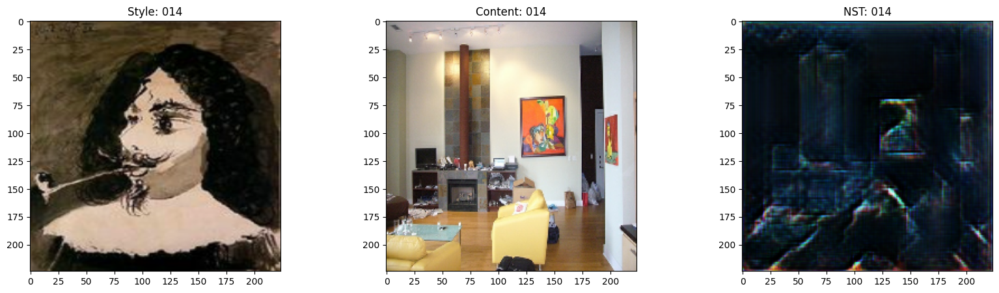

50/50 [==============================] - 94s 2s/step - style_loss: 58.2201 - content_loss: 75.6872 - total_loss: 133.9073 - val_style_loss: 57.4403 - val_content_loss: 75.5020 - val_total_loss: 132.9424
Epoch 16/30
50/50 [==============================] - ETA: 0s - style_loss: 56.1742 - content_loss: 74.1893 - total_loss: 130.3635

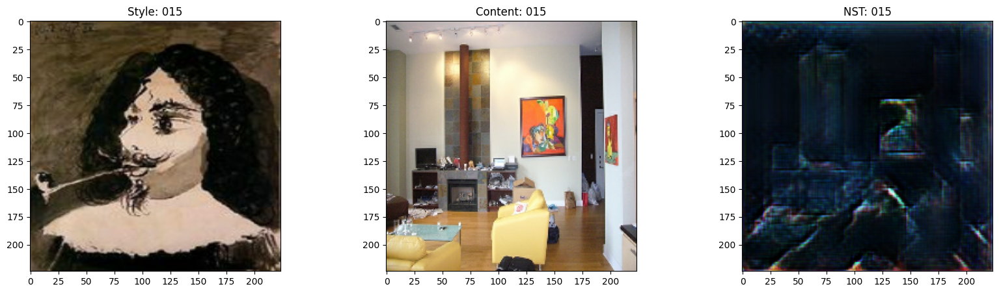

50/50 [==============================] - 94s 2s/step - style_loss: 56.1742 - content_loss: 74.1893 - total_loss: 130.3635 - val_style_loss: 56.0920 - val_content_loss: 72.6961 - val_total_loss: 128.7881
Epoch 17/30
50/50 [==============================] - ETA: 0s - style_loss: 53.2347 - content_loss: 72.0238 - total_loss: 125.2585

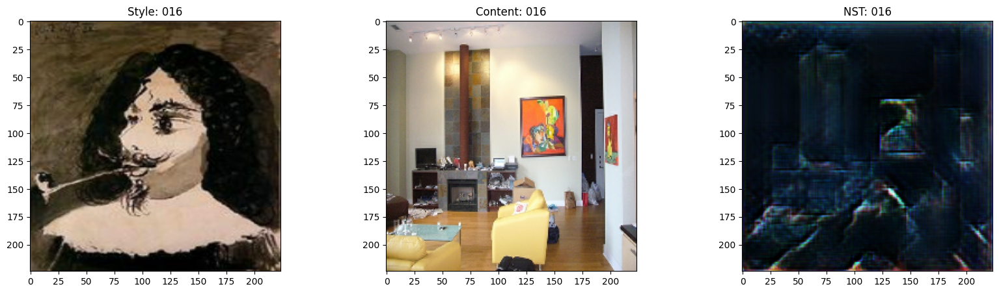

50/50 [==============================] - 93s 2s/step - style_loss: 53.2347 - content_loss: 72.0238 - total_loss: 125.2585 - val_style_loss: 55.4458 - val_content_loss: 71.8847 - val_total_loss: 127.3305
Epoch 18/30
50/50 [==============================] - ETA: 0s - style_loss: 51.4888 - content_loss: 70.9738 - total_loss: 122.4627

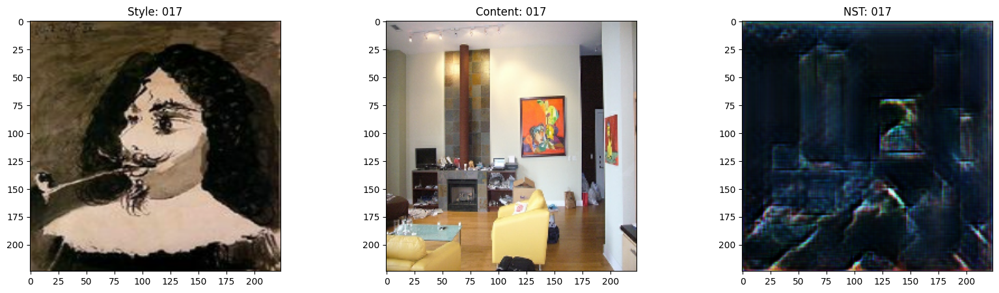

50/50 [==============================] - 103s 2s/step - style_loss: 51.4888 - content_loss: 70.9738 - total_loss: 122.4627 - val_style_loss: 51.6680 - val_content_loss: 72.0391 - val_total_loss: 123.7072
Epoch 19/30
50/50 [==============================] - ETA: 0s - style_loss: 51.1120 - content_loss: 70.7819 - total_loss: 121.8939

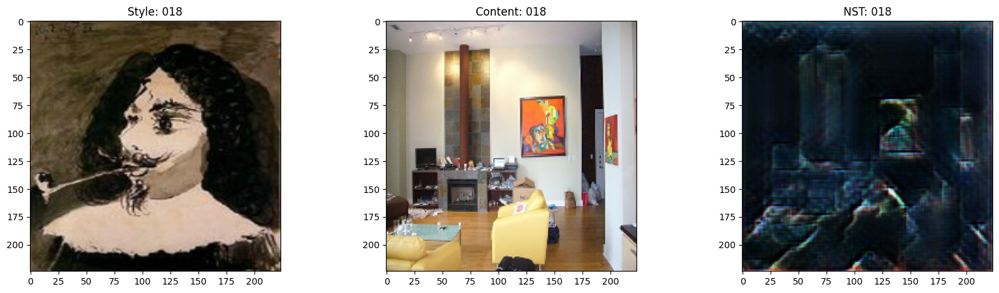

50/50 [==============================] - 103s 2s/step - style_loss: 51.1120 - content_loss: 70.7819 - total_loss: 121.8939 - val_style_loss: 50.4372 - val_content_loss: 71.1576 - val_total_loss: 121.5948
Epoch 20/30
50/50 [==============================] - ETA: 0s - style_loss: 49.3852 - content_loss: 70.0615 - total_loss: 119.4467

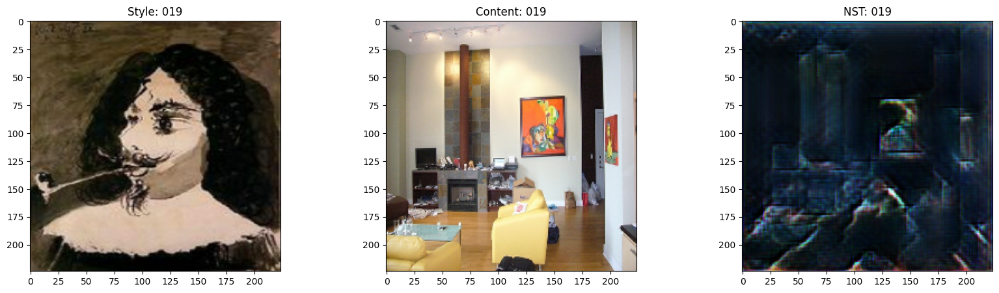

50/50 [==============================] - 94s 2s/step - style_loss: 49.3852 - content_loss: 70.0615 - total_loss: 119.4467 - val_style_loss: 48.8619 - val_content_loss: 69.5300 - val_total_loss: 118.3919
Epoch 21/30
50/50 [==============================] - ETA: 0s - style_loss: 47.5179 - content_loss: 68.2737 - total_loss: 115.7916

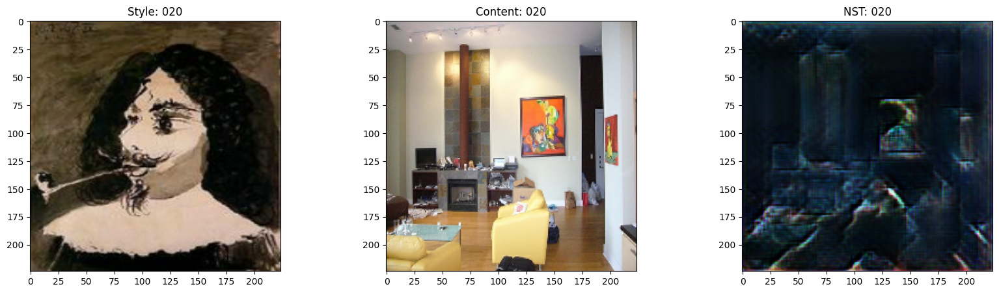

50/50 [==============================] - 94s 2s/step - style_loss: 47.5179 - content_loss: 68.2737 - total_loss: 115.7916 - val_style_loss: 47.9421 - val_content_loss: 68.2818 - val_total_loss: 116.2239
Epoch 22/30
50/50 [==============================] - ETA: 0s - style_loss: 45.5408 - content_loss: 66.3502 - total_loss: 111.8911

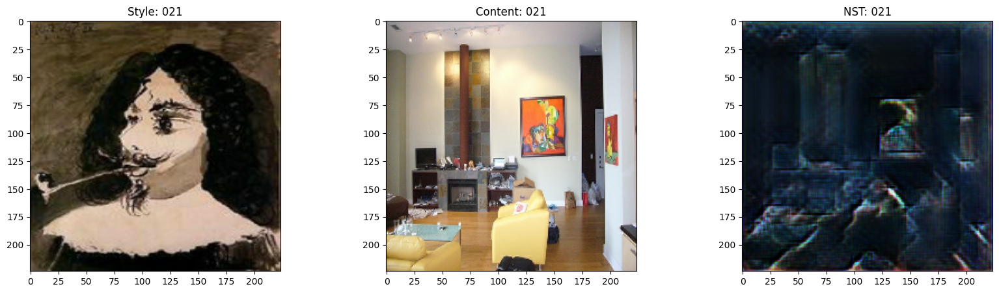

50/50 [==============================] - 103s 2s/step - style_loss: 45.5408 - content_loss: 66.3502 - total_loss: 111.8911 - val_style_loss: 46.6960 - val_content_loss: 67.4998 - val_total_loss: 114.1959
Epoch 23/30
50/50 [==============================] - ETA: 0s - style_loss: 46.0814 - content_loss: 67.4543 - total_loss: 113.5357

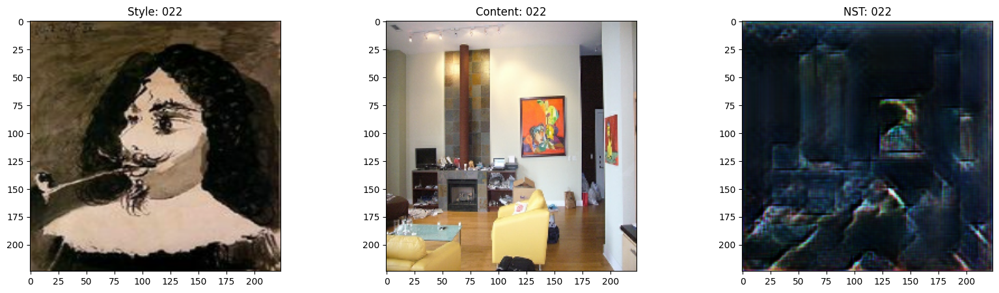

50/50 [==============================] - 103s 2s/step - style_loss: 46.0814 - content_loss: 67.4543 - total_loss: 113.5357 - val_style_loss: 45.4372 - val_content_loss: 66.4794 - val_total_loss: 111.9166
Epoch 24/30
50/50 [==============================] - ETA: 0s - style_loss: 44.4730 - content_loss: 66.3736 - total_loss: 110.8466

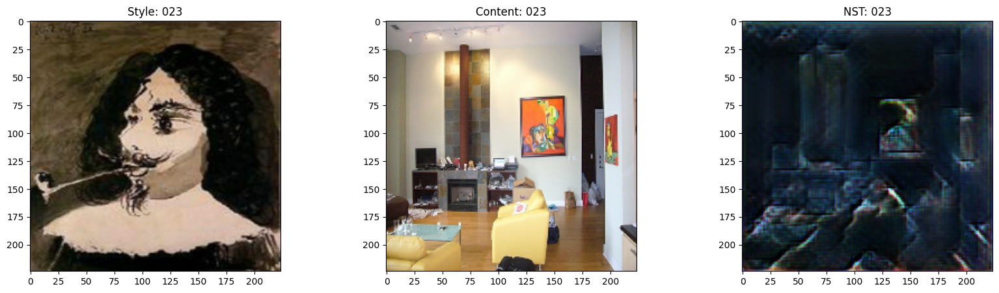

50/50 [==============================] - 94s 2s/step - style_loss: 44.4730 - content_loss: 66.3736 - total_loss: 110.8466 - val_style_loss: 44.5354 - val_content_loss: 65.7457 - val_total_loss: 110.2811
Epoch 25/30
50/50 [==============================] - ETA: 0s - style_loss: 43.3929 - content_loss: 65.0634 - total_loss: 108.4563

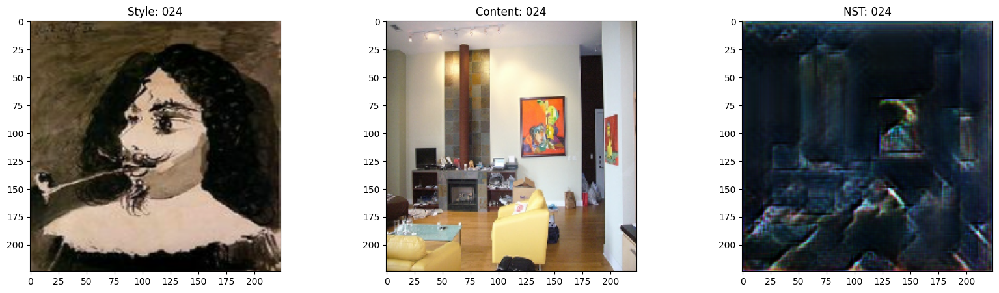

50/50 [==============================] - 94s 2s/step - style_loss: 43.3929 - content_loss: 65.0634 - total_loss: 108.4563 - val_style_loss: 43.5837 - val_content_loss: 65.2221 - val_total_loss: 108.8058
Epoch 26/30
50/50 [==============================] - ETA: 0s - style_loss: 41.6588 - content_loss: 63.4886 - total_loss: 105.1474

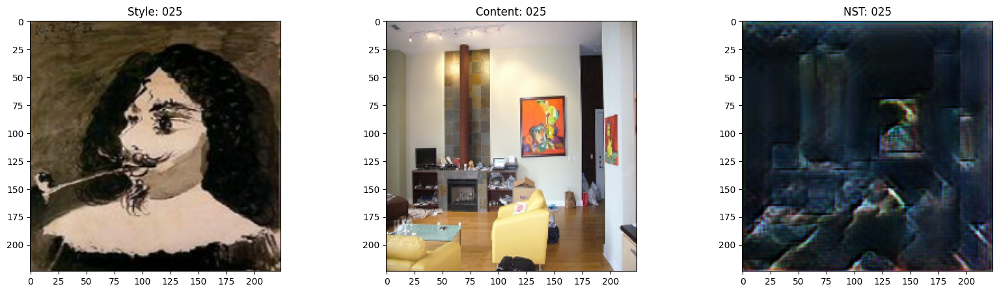

50/50 [==============================] - 94s 2s/step - style_loss: 41.6588 - content_loss: 63.4886 - total_loss: 105.1474 - val_style_loss: 42.5363 - val_content_loss: 64.0839 - val_total_loss: 106.6202
Epoch 27/30
50/50 [==============================] - ETA: 0s - style_loss: 41.1670 - content_loss: 64.2401 - total_loss: 105.4071

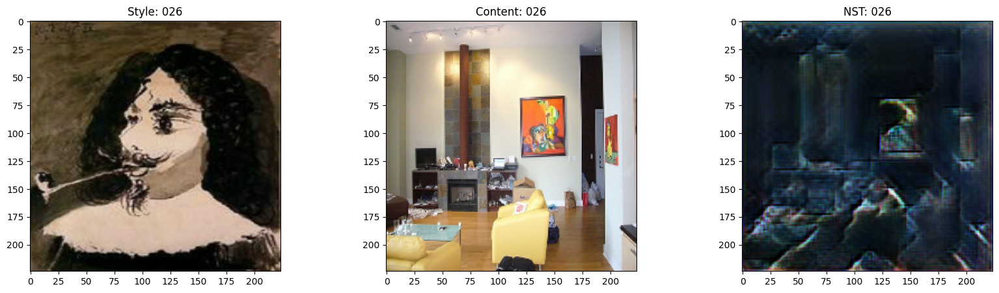

50/50 [==============================] - 103s 2s/step - style_loss: 41.1670 - content_loss: 64.2401 - total_loss: 105.4071 - val_style_loss: 40.9668 - val_content_loss: 64.2611 - val_total_loss: 105.2279
Epoch 28/30
50/50 [==============================] - ETA: 0s - style_loss: 41.3926 - content_loss: 63.6633 - total_loss: 105.0558

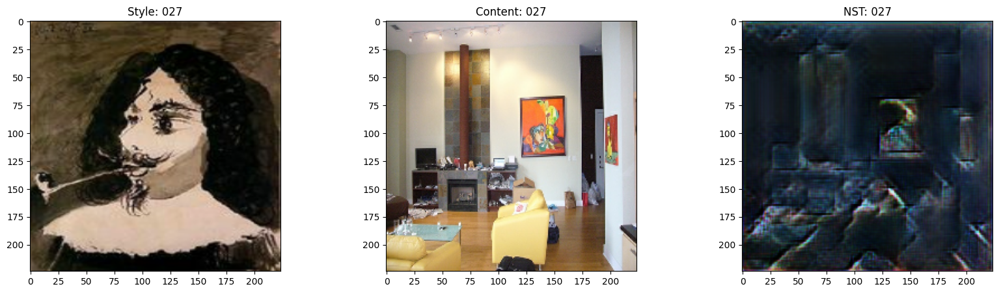

50/50 [==============================] - 94s 2s/step - style_loss: 41.3926 - content_loss: 63.6633 - total_loss: 105.0558 - val_style_loss: 40.8463 - val_content_loss: 62.9014 - val_total_loss: 103.7477
Epoch 29/30
50/50 [==============================] - ETA: 0s - style_loss: 39.9667 - content_loss: 62.4976 - total_loss: 102.4643

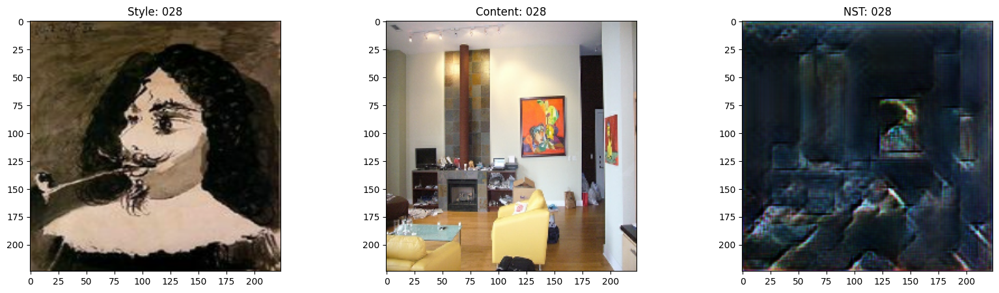

50/50 [==============================] - 94s 2s/step - style_loss: 39.9667 - content_loss: 62.4976 - total_loss: 102.4643 - val_style_loss: 39.6896 - val_content_loss: 62.5421 - val_total_loss: 102.2317
Epoch 30/30
50/50 [==============================] - ETA: 0s - style_loss: 38.5665 - content_loss: 61.4702 - total_loss: 100.0367

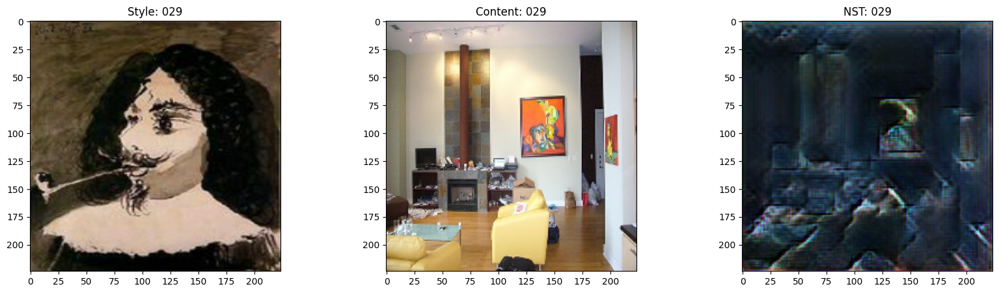

50/50 [==============================] - 103s 2s/step - style_loss: 38.5665 - content_loss: 61.4702 - total_loss: 100.0367 - val_style_loss: 39.1844 - val_content_loss: 61.7048 - val_total_loss: 100.8892


In [22]:
model.compile(optimizer = optimizer, loss_fn = loss)
model.fit(
    train_dataset,
    validation_data = valid_dataset,
    epochs = epochs,
    steps_per_epoch = 50,
    validation_steps = 50,
    callbacks = [TrainMonitor()]
    )

**If train >= 50 epochs so get better result**

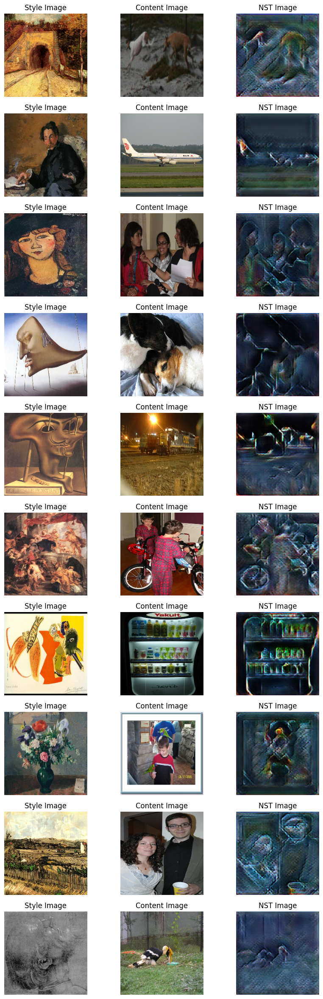

In [24]:
for style, content in test_dataset.take(1):
    style_encoded = model.encoder(style)
    content_encoded = model.encoder(content)
    t = AdaIn_layer(style=style_encoded, content=content_encoded)
    reconstructed_image = model.decoder(t)
    fig, axes = plt.subplots(nrows=10, ncols=3, figsize=(10, 30))
    [ax.axis("off") for ax in np.ravel(axes)]

    for axis, style_image, content_image, reconstructed_image in zip(
        axes, style[0:10], content[0:10], reconstructed_image[0:10]
    ):
        (ax_style, ax_content, ax_reconstructed) = axis
        ax_style.imshow(style_image)
        ax_style.set_title("Style Image")
        ax_content.imshow(content_image)
        ax_content.set_title("Content Image")
        ax_reconstructed.imshow(reconstructed_image)
        ax_reconstructed.set_title("NST Image")